### Virial stress or contact forces

In [1]:
import os
import glob
import matplotlib
import numpy             as     np
import pandas            as     pd
import scipy.optimize    as     opt
import matplotlib.pyplot as     plt
from   matplotlib        import font_manager
from   fractions         import Fraction
import pickle
import warnings
import sys
from   tqdm              import tqdm
import platform
from   pathlib           import Path
import importlib
import plotly.graph_objects as go
import readFiles
importlib.reload(readFiles)

# Matplotlib rc parameters modification
plt.rcParams.update({
  "figure.max_open_warning" : 0,
  "text.usetex"             : True,
  "text.latex.preamble"     : r"\usepackage{amsmath, bm, type1cm}",  # Added \bm for bold math
  "figure.autolayout"       : True,
  "font.family"             : "STIXGeneral",
  "mathtext.fontset"        : "stix",
  "font.size"               : 8,
  "xtick.labelsize"         : 8,
  "ytick.labelsize"         : 8,
  "lines.linewidth"         : 1,
  "lines.markersize"        : 5,
})
#plt.rcParams['text.latex.preamble']= r"\usepackage{amsmath}"
matplotlib.rc('text', usetex=True)
matplotlib.rcParams['text.latex.preamble'] = r'\boldmath'

colors = ['#4a91b5', '#e68139', '#5da258', '#87629b', '#1b9e77']


if platform.system() == 'Darwin':  # macOS
    topDir = Path("/Volumes/rahul_2TB/high_bidispersity/new_data/")
    fig_save_path = Path("/Users/rahul/City College Dropbox/Rahul Pandare/CUNY/research/bidisperse_project/figures/virial_stress/")
elif platform.system() == 'Linux':
    topDir = Path("/media/rahul/rahul_2TB/high_bidispersity/new_data/")
    fig_save_path = Path("/media/Linux_1TB/City College Dropbox/Rahul Pandare/CUNY/research/bidisperse_project/figures/virial_stress/")
else:
    raise OSError("Unsupported OS")

In [2]:
# attempt at 3d plot 
#Angular velocity vs neighbouring k particle angular velocity
# Some simulation parameters

npp  = 1000
runs = 1
phi  = 0.74
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
k    = 6   # number of minimum values
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

angvel_all      = []
neighAngVel_all = []
colors_all      = []
vnorm_all = []

for l in range(runs):
    dataname  = f"{topDir}/NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"  
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r')
    rigFile   = open(glob.glob(f'{dataname}/rig_*.dat' )[0], 'r')
    datdata   = np.genfromtxt(dataFile)
    pardata   = readFiles.readParFile(parFile)
    rigdata   = readFiles.rigList(rigFile)
    srate     = datdata[off:, 2]
    #totStrain = datdata[-1, 1]
    parLines = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r').readlines()
    
    
    lz = float(parLines[3].split()[2]) 
    
    for i, frame in enumerate(pardata[off:]):
        angvel = frame[:, 8]
        pidx   = frame[:, 0]
        px     = frame[:, 2]
        pz     = frame[:, 3]
        vx     = frame[:, 4]
        vy     = frame[:, 5]
        vz     = frame[:, 6]
        sr     = srate[i]
        vx    -= sr * (pz/2)
        v_norm = np.sqrt(vx**2 + vy**2 + vz**2)
        
        xmat, zmat = np.outer(px, np.ones(len(px))), np.outer(pz, np.ones(len(pz))) # broadcasting position array
        dxij, dzij = xmat.transpose() - xmat, zmat.transpose() - zmat        # distance matrix
        dij        = np.sqrt(dxij**2 + dzij**2) # norm dist matrix
        
        for ii in pidx:
            idx         = np.argsort(dij[:, int(ii)])[1:k]
            neighAngVel = np.mean(angvel[idx])
            neighAngVel_all.append(neighAngVel)

        rigList = [set(sum(rigFrame, [])) for rigFrame in rigdata]
        color   = np.array(['white'] * npp)
        color[list(rigList[off+i])] = 'red'
        
        angvel_all.extend(angvel)
        vnorm_all.extend(v_norm)
        colors_all.extend(list(color))

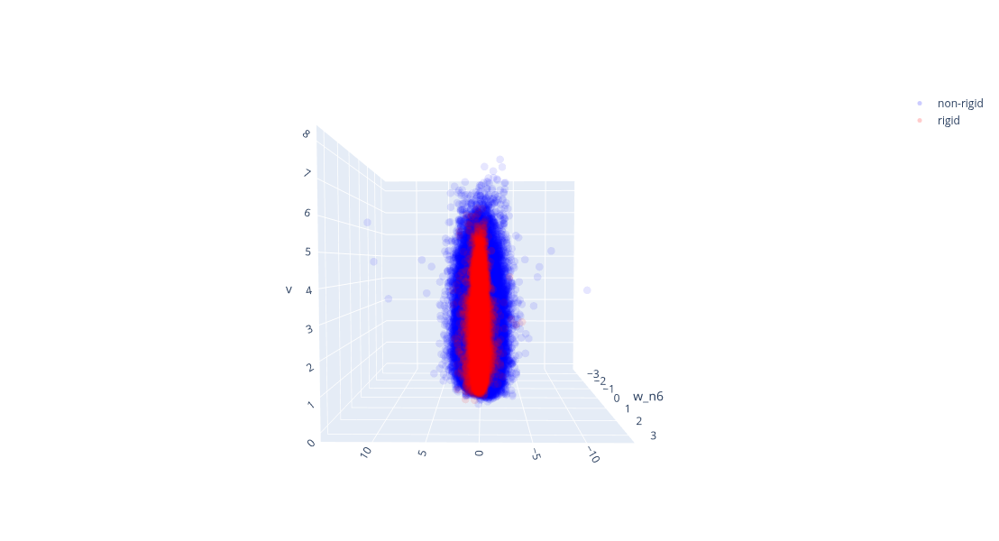

In [14]:
kk = 1e6/3
kk = int(kk)

angvel_all1      = np.array(angvel_all[:kk])
vnorm_all1       = np.array(vnorm_all[:kk])
neighAngVel_all1 = np.array(neighAngVel_all[:kk])
colors_all1      = np.array(colors_all[:kk])

is_red  = colors_all1 == 'red'
not_red = ~is_red

fig = go.Figure([
    go.Scatter3d(
        x=np.atleast_1d(angvel_all1[not_red]),
        y=np.atleast_1d(neighAngVel_all1[not_red]),
        z=np.atleast_1d(vnorm_all1[not_red]),
        mode='markers',
        marker=dict(size=5, color='blue', opacity=0.1, line=dict(width=0.0, color='black')),
        name='non-rigid'),
    go.Scatter3d(
        x=np.atleast_1d(angvel_all1[is_red]),
        y=np.atleast_1d(neighAngVel_all1[is_red]),
        z=np.atleast_1d(vnorm_all1[is_red]),
        mode='markers',
        marker=dict(size=5, color='red', opacity=0.1, line=dict(width=0.0, color='black')),
        name='rigid')
])

fig.update_layout(scene=dict(xaxis_title='w',yaxis_title='w_n6',zaxis_title='v',
                             aspectmode='manual',aspectratio=dict(x=1, y=1, z=1)),
                             width=500, height=400)


fig.show()

In [2]:
## virial_stress.txt analysis

# Simulation data mount point

# Some simulation parameters.
npp  = 1000
runs = 1
phi  = 0.76
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

tstrain         = 0.01
angvel_all      = []
neighAngVel_all = []
colors_all      = []

for l in range(runs):
    dataname   = f"{topDir}/NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"  
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r')
    rigFile   = open(glob.glob(f'{dataname}/rig_*.dat' )[0], 'r')
    datdata   = np.genfromtxt(dataFile)
    totStrain = datdata[-1, 1]
    srate     = datdata[off:, 2]
    pardata   = readFiles.readParFile(parFile)
    rigdata   = readFiles.rigList(rigFile)
    
    pardata_stack = np.vstack(pardata[off:])

    rigList = [set(sum(rigFrame, [])) for rigFrame in rigdata]
    color   = ['white'] * (npp * int(totStrain * 100 - off +1))
    for i, rigFrame in enumerate(rigList[off:]):
        base_idx = i * npp
        for j in rigFrame:
            idx  = base_idx + j + 1
            if idx < len(color):  # avoid index error
                color[idx] = 'r'
    
    srate_all = np.repeat(srate, npp)
    angvel_all.extend(pardata_stack[:, 8]/srate_all) # dont change
    
    colors_all.extend(color)

In [8]:
pardata[1000][:, 8]

0.046298904579

In [113]:
## Angular velocity vs neighbouring k particle angular velocity
# Some simulation parameters

npp  = 1000
runs = 1
phi  = 0.77
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
k    = 6   # number of minimum values
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

angvel_all      = []
neighAngVel_all = []
colors_all      = []

for l in range(runs):
    dataname  = f"{topDir}/NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"  
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r')
    rigFile   = open(glob.glob(f'{dataname}/rig_*.dat' )[0], 'r')
    datdata   = np.genfromtxt(dataFile)
    pardata   = readFiles.readParFile(parFile)
    rigdata   = readFiles.rigList(rigFile)
    totStrain = datdata[-1, 1]
    
    for i, frame in enumerate(pardata[off:]):
        angvel = frame[:,8]
        pidx   = frame[:, 0]
        px     = frame[:, 2]
        pz     = frame[:, 3]
        
        xmat, zmat = np.outer(px, np.ones(len(px))), np.outer(pz, np.ones(len(pz))) # broadcasting position array
        dxij, dzij = xmat.transpose() - xmat, zmat.transpose() - zmat        # distance matrix
        dij        = np.sqrt(dxij**2 + dzij**2) # norm dist matrix
        
        for ii in pidx:
            idx         = np.argsort(dij[:, int(ii)])[1:k]
            neighAngVel = np.mean(angvel[idx])
            neighAngVel_all.append(neighAngVel)

        rigList = [set(sum(rigFrame, [])) for rigFrame in rigdata]
        color   = np.array(['white'] * npp)
        color[list(rigList[off+i])] = 'r'

        angvel_all.extend(angvel)
        colors_all.extend(list(color))

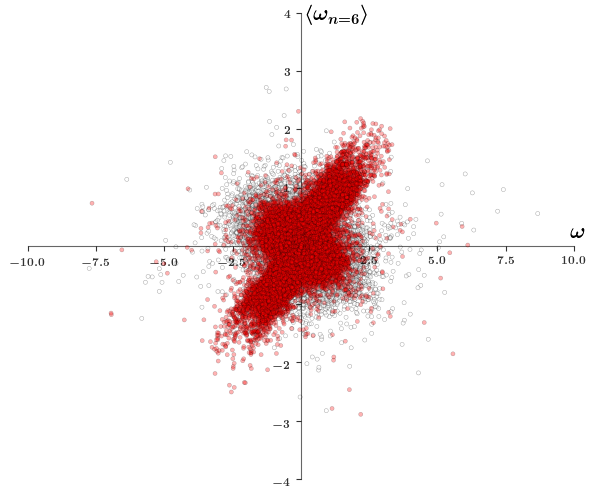

In [114]:
plt.figure(figsize = (6, 5))

angvel_all      = np.array(angvel_all)
neighAngVel_all = np.array(neighAngVel_all)
colors_all      = np.array(colors_all)

is_red  = colors_all == 'r' # index of red points
not_red = ~is_red             # index of non-red points

plt.scatter(angvel_all[not_red], neighAngVel_all[not_red],      # non-red points below
            s=35, c=colors_all[not_red], alpha=0.4, marker='.',
            linewidths=0.3, edgecolors='k', zorder=1)

plt.scatter(angvel_all[is_red], neighAngVel_all[is_red],        # red points above
            s=35, c=colors_all[is_red], alpha=0.3, marker='.',
            linewidths=0.3, edgecolors='k', zorder=10)

ax = plt.gca()
for spine in ['left', 'bottom']:
    ax.spines[spine].set_position('zero')
    ax.spines[spine].set_alpha(0.6)
for spine in ['top', 'right']:
    ax.spines[spine].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.set_xticks([t for t in ax.get_xticks() if t != 0])
ax.set_yticks([t for t in ax.get_yticks() if t != 0])
#ax.set_ylim(-4, 4)   #angvel_neigh
#ax.set_xlim(-12, 12) #angvel

for tick in ax.xaxis.get_major_ticks() + ax.yaxis.get_major_ticks():
    tick.tick1line.set_alpha(0.8)
    tick.label1.set_alpha(0.8)
ax.set_xlabel(r'$\omega$', labelpad=15, ha='right', fontsize=15)
ax.set_ylabel(fr'$\langle \omega_{{n={k}}} \rangle$', labelpad=10, va='top', rotation=0, fontsize=15)
ax.xaxis.set_label_coords(1.02, 0.55)
ax.yaxis.set_label_coords(0.57, 1.02)
plt.savefig(f"{fig_save_path}/angvel_{k}-neighbor_rigid_phi_{phi}_ar_{ar}_vr_{vr}.png", bbox_inches="tight", dpi=800, transparent=False)
plt.show()

In [21]:
## Angular velocity vs neighbouring k particle angular velocity
# normalized wrt shear rate
# Some simulation parameters

npp  = 1000
runs = 1
phi  = 0.77
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
k    = 6  # number of minimum values
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

angvel_all      = []
neighAngVel_all = []
colors_all      = []

for l in range(runs):
    dataname  = f"{topDir}/NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"  
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r')
    rigFile   = open(glob.glob(f'{dataname}/rig_*.dat' )[0], 'r')
    datdata   = np.genfromtxt(dataFile)
    pardata   = readFiles.readParFile(parFile)
    rigdata   = readFiles.rigList(rigFile)
    srate     = datdata[off:, 2]
    totStrain = datdata[-1, 1]
    
    for i, frame in enumerate(pardata[off:]):
        angvel = frame[:,8]
        pidx   = frame[:, 0]
        px     = frame[:, 2]
        pz     = frame[:, 3]
        sr     = srate[i]
        
        xmat, zmat = np.outer(px, np.ones(len(px))), np.outer(pz, np.ones(len(pz))) # broadcasting position array
        dxij, dzij = xmat.transpose() - xmat, zmat.transpose() - zmat        # distance matrix
        dij        = np.sqrt(dxij**2 + dzij**2) # norm dist matrix
        
        for ii in pidx:
            idx         = np.argsort(dij[:, int(ii)])[1:k]
            neighAngVel = np.mean(angvel[idx])
            neighAngVel_all.append(neighAngVel/sr)

        rigList = [set(sum(rigFrame, [])) for rigFrame in rigdata]
        color   = np.array(['white'] * npp)
        color[list(rigList[off+i])] = 'r'

        angvel_all.extend(angvel/sr)
        colors_all.extend(list(color))

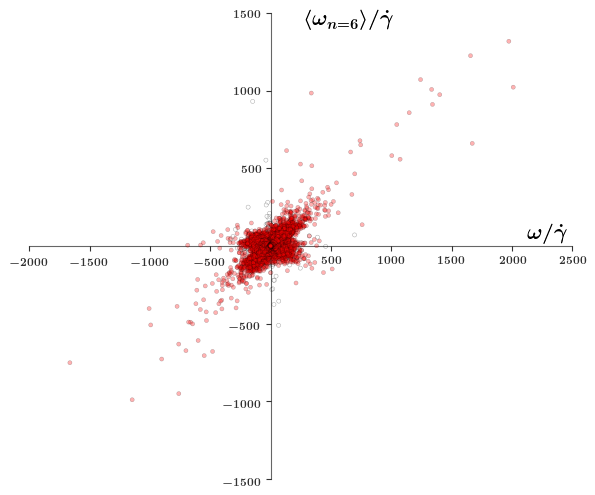

In [22]:
plt.figure(figsize = (6, 5))

angvel_all      = np.array(angvel_all)
neighAngVel_all = np.array(neighAngVel_all)
colors_all      = np.array(colors_all)

is_red  = colors_all == 'r' # index of red points
not_red = ~is_red             # index of non-red points

plt.scatter(angvel_all[not_red], neighAngVel_all[not_red],      # non-red points below
            s=35, c=colors_all[not_red], alpha=0.4, marker='.',
            linewidths=0.3, edgecolors='k', zorder=1)

plt.scatter(angvel_all[is_red], neighAngVel_all[is_red],        # red points above
            s=35, c=colors_all[is_red], alpha=0.3, marker='.',
            linewidths=0.3, edgecolors='k', zorder=10)

ax = plt.gca()
for spine in ['left', 'bottom']:
    ax.spines[spine].set_position('zero')
    ax.spines[spine].set_alpha(0.6)
for spine in ['top', 'right']:
    ax.spines[spine].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.set_xticks([t for t in ax.get_xticks() if t != 0])
ax.set_yticks([t for t in ax.get_yticks() if t != 0])
#ax.set_ylim(-30, 30)   #angvel_neigh
#ax.set_xlim(-100, 100) #angvel

for tick in ax.xaxis.get_major_ticks() + ax.yaxis.get_major_ticks():
    tick.tick1line.set_alpha(0.8)
    tick.label1.set_alpha(0.8)
ax.set_xlabel(r'$\omega/ \dot \gamma$', labelpad=15, ha='right', fontsize=15)
ax.set_ylabel(fr'$\langle \omega_{{n={k}}} \rangle / \dot \gamma$', labelpad=10, va='top', rotation=0, fontsize=15)
ax.xaxis.set_label_coords(0.99, 0.55)
ax.yaxis.set_label_coords(0.59, 1.01)
plt.savefig(f"{fig_save_path}/angvel_{k}-neighbor_sr_rigid_phi_{phi}_ar_{ar}_vr_{vr}.png", bbox_inches="tight", dpi=800, transparent=False)
plt.show()

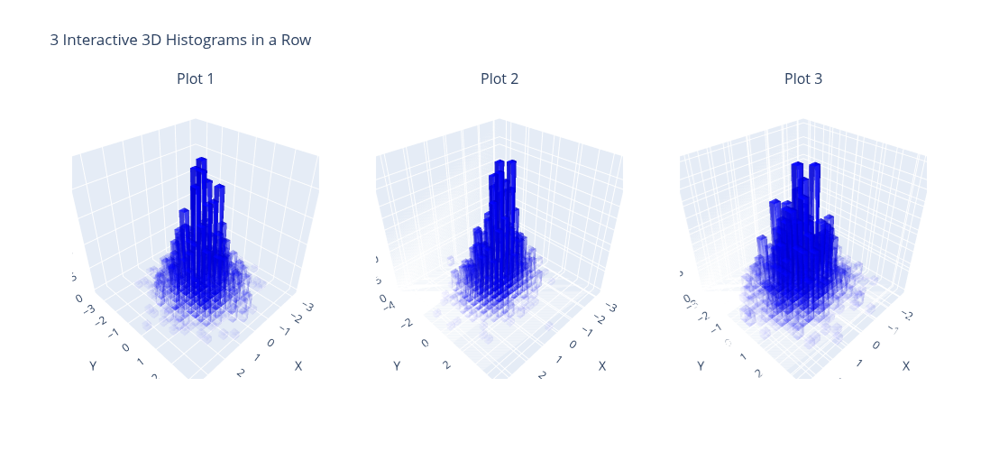

In [26]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Reuse the previous make_bar function for bars
def make_bar(x, y, z, dx, dy, dz, color):
    corners = np.array([
        [x, y, z],
        [x+dx, y, z],
        [x+dx, y+dy, z],
        [x, y+dy, z],
        [x, y, z+dz],
        [x+dx, y, z+dz],
        [x+dx, y+dy, z+dz],
        [x, y+dy, z+dz],
    ])
    I = [0, 0, 0, 1, 1, 2, 3, 4, 4, 5, 6, 7]
    J = [1, 3, 4, 2, 5, 3, 7, 5, 7, 6, 7, 6]
    K = [2, 2, 5, 3, 6, 7, 4, 6, 6, 7, 4, 3]
    return go.Mesh3d(
        x=corners[:, 0], y=corners[:, 1], z=corners[:, 2],
        i=I, j=J, k=K, color=color, opacity=0.7,
        showscale=False,
    )

# Generate sample data sets
data_list = []
for _ in range(3):
    x = np.random.randn(1000)
    y = np.random.randn(1000)
    hist, xedges, yedges = np.histogram2d(x, y, bins=20)
    data_list.append((hist, xedges, yedges))

# Create subplot figure with 3 scenes in a row
fig = make_subplots(
    rows=1, cols=3,
    specs=[[{'type':'scene'}, {'type':'scene'}, {'type':'scene'}]],
    subplot_titles=("Plot 1", "Plot 2", "Plot 3")
)

# Bar dimensions (same for all)
dx = (data_list[0][1][1] - data_list[0][1][0]) * 0.9
dy = (data_list[0][2][1] - data_list[0][2][0]) * 0.9

for idx, (hist, xedges, yedges) in enumerate(data_list, start=1):
    max_count = hist.max()
    for i in range(hist.shape[0]):
        for j in range(hist.shape[1]):
            if hist[i, j] > 0:
                x_val = xedges[i]
                y_val = yedges[j]
                z_val = 0
                dz = hist[i, j]
                color_val = dz / max_count
                color = f'rgba(0,0,255,{color_val})'
                bar = make_bar(x_val, y_val, z_val, dx, dy, dz, color)
                fig.add_trace(bar, row=1, col=idx)

    # Set axis titles for each subplot's scene
    fig.update_layout({
        f'scene{idx}': dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Count',
            aspectmode='cube'
        )
    })

fig.update_layout(height=500, width=1200, title_text="3 Interactive 3D Histograms in a Row")

fig.show()

In [19]:
np.outer([1,2,3], [1,1,1]) - np.outer([1,2,3], [1,1,1]).transpose()

array([[ 0, -1, -2],
       [ 1,  0, -1],
       [ 2,  1,  0]])

In [66]:
colors_all

array(['r', 'white', 'r', ..., 'white', 'white', 'white'], dtype='<U5')

In [69]:
sum(is_red)

386886

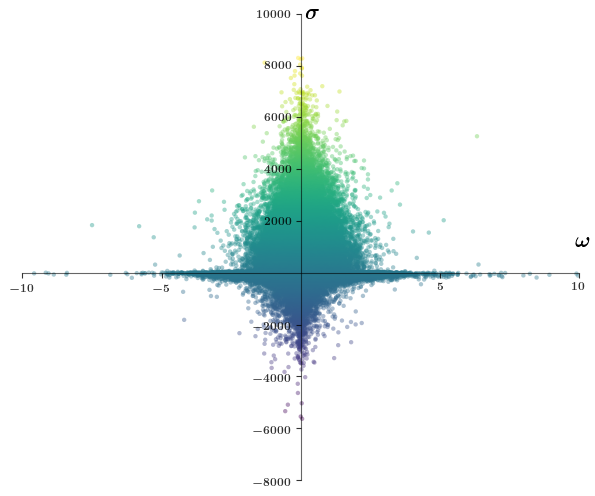

In [13]:
## virial_stress.txt analysis

# Simulation data mount point
#topDir = "/Volumes/rahul_2TB/high_bidispersity/new_data/"
topDir  = "/media/rahul/rahul_2TB/high_bidispersity/new_data/"

fig_save_path = "/media/Linux_1TB/City College Dropbox/Rahul Pandare/CUNY/research/bidisperse_project/figures/virial_stress/"

# Some simulation parameters.
npp  = 1000
runs = 2
phi  = 0.76
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

tstrain    = 0.01
angvel_all = []
stress_all = []

for l in range(runs):
    dataname   = f"{topDir}NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"
    virialfile = f"{dataname}/virial_stress_tensor.txt"
    if not os.path.exists(virialfile):
        continue
    virFile   = open(virialfile, 'r')
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat')[0], 'r')
    totStrain = np.genfromtxt(dataFile)[-1,1]
    pardata   = readFiles.readParFile(parFile)
    
    viraldata     = np.genfromtxt(virFile)
    pardata_stack = np.vstack(pardata[off:])
    
    angvel_all.extend(pardata_stack[:, 8]) # dont change
    stress_all.extend(viraldata[:, 12])    # 9: xx, 10: xy, 12: yy

plt.figure(figsize=(6, 5))
plt.scatter(angvel_all, stress_all, s=40, c=stress_all, cmap='viridis', alpha=0.4, marker='.', linewidths=0)
ax = plt.gca()
for spine in ['left', 'bottom']:
    ax.spines[spine].set_position('zero')
    ax.spines[spine].set_alpha(0.6)
for spine in ['top', 'right']:
    ax.spines[spine].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.set_xticks([t for t in ax.get_xticks() if t != 0])
ax.set_yticks([t for t in ax.get_yticks() if t != 0])
#ax.set_ylim(-5e3, 5e3)
ax.set_xlim(-10, 10)

for tick in ax.xaxis.get_major_ticks() + ax.yaxis.get_major_ticks():
    tick.tick1line.set_alpha(0.8)
    tick.label1.set_alpha(0.8)
ax.set_xlabel(r'$\omega$', labelpad=15, ha='right', fontsize=15)
ax.set_ylabel(r'$\sigma$', labelpad=10, va='top', rotation=0, fontsize=15)
ax.xaxis.set_label_coords(1.02, 0.53)
ax.yaxis.set_label_coords(0.52, 1.02)
plt.savefig(f"{fig_save_path}virial_angvel_phi_{phi}_ar_{ar}_vr_{vr}_total_yy.png", bbox_inches="tight", dpi=800, transparent=True)
plt.show()

In [7]:
## virial_stress.txt analysis

# Simulation data mount point

# Some simulation parameters.
npp  = 1000
runs = 1
phi  = 0.76
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

tstrain    = 0.01
angvel_all = []
stress_all = []
colors_all = []

for l in range(runs):
    dataname   = f"{topDir}/NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"
    virialfile = f"{dataname}/virial_stress_tensor.txt"
    if not os.path.exists(virialfile):
        continue
    virFile   = open(virialfile, 'r')
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r')
    rigFile   = open(glob.glob(f'{dataname}/rig_*.dat' )[0], 'r')
    datdata   = np.genfromtxt(dataFile)
    totStrain = datdata[-1, 1]
    srate     = datdata[off:, 2]
    pardata   = readFiles.readParFile(parFile)
    rigdata   = readFiles.rigList(rigFile)
    
    viraldata     = np.genfromtxt(virFile)[off*npp:,:]
    pardata_stack = np.vstack(pardata[off:])

    rigList = [set(sum(rigFrame, [])) for rigFrame in rigdata]
    color   = ['white'] * (npp * int(totStrain * 100 - off +1))
    for i, rigFrame in enumerate(rigList[off:]):
        base_idx = i * npp
        for j in rigFrame:
            idx  = base_idx + j + 1
            if idx < len(color):  # avoid index error
                color[idx] = 'r'
    
    srate_all = np.repeat(srate, npp)
    angvel_all.extend(pardata_stack[:, 8]/srate_all) # dont change
    stress_all.extend(viraldata[:, 10]) #9: xx, 10: xy, 12: yy
    colors_all.extend(color)

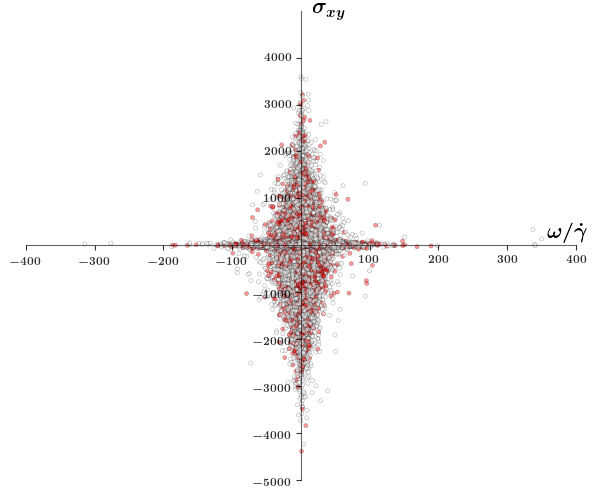

In [47]:
plt.figure(figsize=(6, 5))
plt.scatter(angvel_all, stress_all, s=35, c=colors_all, alpha=0.4, marker='.', linewidths=0.3, edgecolors='k')
ax = plt.gca()
for spine in ['left', 'bottom']:
    ax.spines[spine].set_position('zero')
    ax.spines[spine].set_alpha(0.6)
for spine in ['top', 'right']:
    ax.spines[spine].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.set_xticks([t for t in ax.get_xticks() if t != 0])
ax.set_yticks([t for t in ax.get_yticks() if t != 0])
ax.set_ylim(-5e3, 5e3)
#ax.set_xlim(-20, 20)

for tick in ax.xaxis.get_major_ticks() + ax.yaxis.get_major_ticks():
    tick.tick1line.set_alpha(0.8)
    tick.label1.set_alpha(0.8)
ax.set_xlabel(r'$\omega/\dot \gamma$', labelpad=15, ha='right', fontsize=15)
ax.set_ylabel(r'$\sigma_{xy}$', labelpad=10, va='top', rotation=0, fontsize=15)
ax.xaxis.set_label_coords(1.02, 0.55)
ax.yaxis.set_label_coords(0.55, 1.02)
plt.savefig(f"{fig_save_path}/virial_angvel_rigid_phi_{phi}_ar_{ar}_vr_{vr}_total_xy.png", bbox_inches="tight", dpi=800, transparent=False)
plt.show()

In [36]:
# finding frames and idex of particles with extreme omega/sr

# Get indices of top 3 maximum angular velocities
top3_indices = np.argsort(angvel_all)[-3:][::-1]  # Descending order

for rank, idx in enumerate(top3_indices, 1):
    max_angvel = angvel_all[idx]
    frame = int(np.floor(idx / npp))
    pindex = int(idx % npp)
    
    print(f"#{rank}")
    print(f"  max angular velocity: {max_angvel}")
    print(f"  index in angvel_all: {idx}")
    print(f"  Frame number: {frame}")
    print(f"  Particle index within frame: {pindex}")

#1
  max angular velocity: 350.2643035302852
  index in angvel_all: 1378
  Frame number: 1
  Particle index within frame: 378
#2
  max angular velocity: 340.7182107673641
  index in angvel_all: 1517337
  Frame number: 1517
  Particle index within frame: 337
#3
  max angular velocity: 340.0012617146702
  index in angvel_all: 363255
  Frame number: 363
  Particle index within frame: 255


In [32]:
pardata[off+frame][pindex, 8] / srate[frame]

350.2643035302852

In [46]:
import numpy as np
from tabulate import tabulate

# Ensure angvel_all is a NumPy array
angvel_all = np.array(angvel_all)
off = 100
threshold = 100
high_omega_indices = np.where(angvel_all > threshold)[0]

# Prepare data
table_data = []
frame_list = []

for idx in high_omega_indices:
    omega_val = angvel_all[idx]
    frame = int(np.floor(idx / npp))
    pindex = int(idx % npp)
    
    table_data.append([idx, omega_val, frame, pindex])
    frame_list.append(frame)

# Print table
headers = ["Index", "Angular Velocity", "Frame", "Particle Index"]
print(f"\nParticles with angular velocity > {threshold}:\n")
print(tabulate(table_data, headers=headers, floatfmt=".3f"))

# Print frame list
print("\nFrames with angvel > 100:")
sorted_frames = sorted(set(np.array(frame_list) + off))
print(sorted_frames) # list of all the frames which have angular velocity higher than the mentioned threshold 


Particles with angular velocity > 100:

      Index    Angular Velocity    Frame    Particle Index
-----------  ------------------  -------  ----------------
   1062.000             337.673        1                62
   1378.000             350.264        1               378
 124233.000             105.416      124               233
 128242.000             189.449      128               242
 129313.000             103.332      129               313
 129369.000             150.699      129               369
 131538.000             125.457      131               538
 156334.000             101.675      156               334
 174573.000             104.249      174               573
 363116.000             135.641      363               116
 363118.000             151.069      363               118
 363255.000             340.001      363               255
 363709.000             122.071      363               709
 374157.000             106.585      374               157
 405389.000    

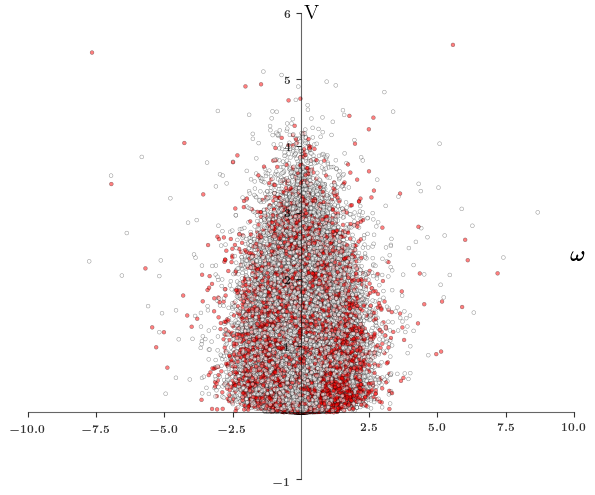

In [5]:
## virial_stress.txt analysis

# Simulation data mount point
topDir = "/Volumes/rahul_2TB/high_bidispersity/new_data/"
#topDir  = "/media/rahul/rahul_2TB/high_bidispersity/new_data/"

#fig_save_path = "/media/Linux_1TB/City College Dropbox/Rahul Pandare/CUNY/research/bidisperse_project/figures/virial_stress/"
fig_save_path = "/Users/rahul/City College Dropbox/Rahul Pandare/CUNY/research/bidisperse_project/figures/virial_stress"

# Some simulation parameters.
npp  = 1000
runs = 1
phi  = 0.77
vr   = '0.5'
ar   = 1.4 #[1.0, 1.4, 2.0, 4.0]
off  = 100
phir = '{:.3f}'.format(phi) if len(str(phi).split('.')[1])>2 else '{:.2f}'.format(phi)

tstrain    = 0.01
angvel_all = []
#stress_all = []
trans_vel = []
colors_all = []

for l in range(runs):
    dataname   = f"{topDir}NP_{npp}/phi_{phir}/ar_{ar}/Vr_{vr}/run_{l+1}"
    virialfile = f"{dataname}/virial_stress_tensor.txt"
    if not os.path.exists(virialfile):
        continue
    virFile   = open(virialfile, 'r')
    dataFile  = open(glob.glob(f'{dataname}/data_*.dat')[0], 'r')
    parFile   = open(glob.glob(f'{dataname}/par_*.dat' )[0], 'r')
    rigFile   = open(glob.glob(f'{dataname}/rig_*.dat' )[0], 'r')
    totStrain = np.genfromtxt(dataFile)[-1,1]
    pardata   = readFiles.readParFile(parFile)
    rigdata   = readFiles.rigList(rigFile)
    
    viraldata     = np.genfromtxt(virFile)
    pardata_stack = np.vstack(pardata[off:])

    rigList = [set(sum(rigFrame, [])) for rigFrame in rigdata]
    color   = ['white'] * (npp * int(totStrain * 100 - off))
    for i, rigFrame in enumerate(rigList[off:]):
        base_idx = i * npp
        for j in rigFrame:
            idx = base_idx + j + 1
            if idx < len(color):  # avoid index error
                color[idx] = 'r'

    angvel_all.extend(pardata_stack[:, 8]) # dont change
    #stress_all.extend(viraldata[:, 12]) #9: xx, 10: xy, 12: yy
    vx = pardata_stack[:, 4]
    vy = pardata_stack[:, 6]
    norm_vel = np.sqrt(vx**2 + vy**2)
    trans_vel.extend(norm_vel)
    colors_all.extend(color)
    
plt.figure(figsize=(6, 5))
plt.scatter(angvel_all, trans_vel, s=30, c=colors_all, alpha=0.5, marker='.', linewidths=0.3, edgecolors='k')
ax = plt.gca()
for spine in ['left', 'bottom']:
    ax.spines[spine].set_position('zero')
    ax.spines[spine].set_alpha(0.6)
for spine in ['top', 'right']:
    ax.spines[spine].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.set_xticks([t for t in ax.get_xticks() if t != 0])
ax.set_yticks([t for t in ax.get_yticks() if t != 0])
#ax.set_ylim(-6e3, 8e3)
ax.set_xlim(-10, 10)

for tick in ax.xaxis.get_major_ticks() + ax.yaxis.get_major_ticks():
    tick.tick1line.set_alpha(0.8)
    tick.label1.set_alpha(0.8)
ax.set_xlabel(r'$\omega$', labelpad=15, ha='right', fontsize=15)
ax.set_ylabel('V', labelpad=10, va='top', rotation=0, fontsize=15)
ax.xaxis.set_label_coords(1.02, 0.50)
ax.yaxis.set_label_coords(0.52, 1.02)
plt.savefig(f"{fig_save_path}transvel_angvel_rigid_phi_{phi}_ar_{ar}_vr_{vr}.png", bbox_inches="tight", dpi=800, transparent=True)
plt.show()

[7.0, 2.0, 3.0, 1.0] 

[14.0, 7.0, 6.0, 1.0] 

[99.0, 71.0, 27.0, 1.0] 



<Figure size 640x480 with 0 Axes>

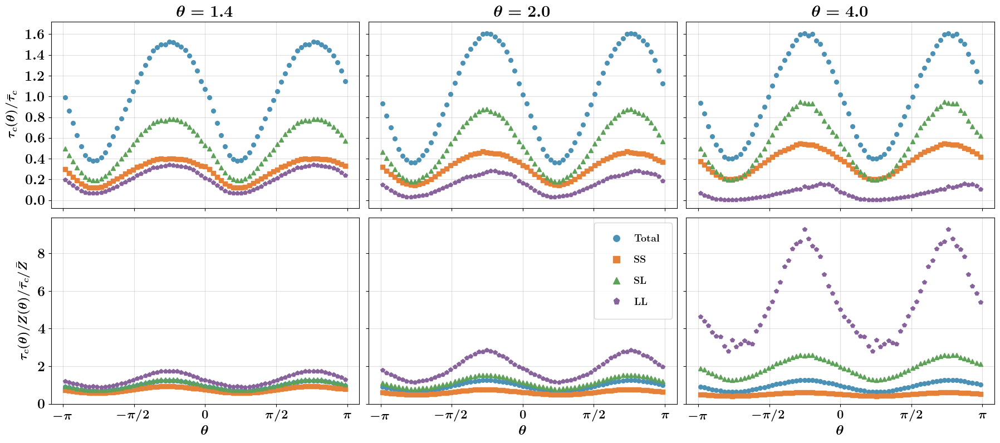

In [2]:
# plot 2 (with normalization)
from matplotlib.ticker import FixedLocator
plt.clf()

topDir        = '/media/rahul/Rahul_2TB/high_bidispersity'
fig_save_path = '/media/Linux_1TB/City College Dropbox/Rahul Pandare/CUNY/Research/Bidisperse Project/analysis/figures/angular_plots/angular_virial_stress/'

ranSeedFile = "random_seed.dat"
intFile     = "int_random_seed_params_stress100r_shear.dat"
contFile    = 'contacts.txt'

npp  = 1000 # no. of particles
off  = 100  # steady state cut off
runs = 4
angleBins  = np.linspace(-np.pi, np.pi,72)
binCenters = (angleBins[:-1] + angleBins[1:])/2

phii = 0.75
ar   = [1.4, 2.0, 4.0]

sizePair     = ['Total', 'SS', 'SL', 'LL']
line_markers = ['o', 's', '^', 'p']
colors       = ['#4a91b5', '#e68139', '#5da258', '#87629b', '#1b9e77']
linestyles   = ['None', 'None', 'None', 'None']
plotType     = [r'$\tau_{c}(\theta)/\bar{\tau_{c}}$',r'$\tau_{c}(\theta)/Z(\theta)/\bar{\tau_{c}}/\bar{Z}$']

fig, axs = plt.subplots(len(plotType), len(ar), figsize=(6*len(ar), 4*len(plotType)))

for j, arj in enumerate(ar):
    phir = '{:.3f}'.format(phii) if len(str(phii).split('.')[1])>2 else '{:.2f}'.format(phii)
    if arj == 4.0: phir ='0.78'
    dataname     = topDir + '/NP_' + str(npp) + '/phi_' + phir + '/ar_' + str(arj) + '/Vr_0.5'

    forceBin_Sum = [[0]*len(binCenters) for _ in range(len(sizePair))] # empty nested list for all four runs 
    contList_Sum = [[0]*len(binCenters) for _ in range(len(sizePair))]
    contCount    = [0]*len(sizePair)

    if os.path.exists(dataname):
        for l in range (runs):
            ranFile      = open(f'{dataname}/run_{l+1}/{ranSeedFile}', 'r')
            particleSize = particleSizeList(ranFile, sizeRatio = arj) 
    
            interFile = open(f'{dataname}/run_{l+1}/{intFile}', 'r')
            intList   = interactionsList(interFile) 
           
            for sampleList in intList[off:]:
                for i in range (sampleList.shape[0]):
                    particleSize1 = particleSize[int(sampleList[i,0])]
                    particleSize2 = particleSize[int(sampleList[i,1])]
                    gap           = sampleList[i,5]
                    contState     = int(sampleList[i,10]) # Contact state
                    contForce     = sampleList[i,11] # Norm of normal contact force
                    r             = (gap+2)*(particleSize1 + particleSize2)/2 # center distance of particles
                    virialStress  = r*contForce
                    thetaRad      = np.arctan2(sampleList[i,4], sampleList[i,2])
    
                    if contState == 2:
                        # For all particles.
                        updateContForce(thetaRad, binCenters, forceBin_Sum[0], contList_Sum[0], virialStress)
                        contCount[0] += 2
                        
                        # Small-Small.
                        if (particleSize1 == particleSize2 == 1):
                            updateContForce(thetaRad, binCenters, forceBin_Sum[1], contList_Sum[1], virialStress)
                            contCount[1] += 2
    
                        # Small-Large
                        elif (particleSize1 != particleSize2):
                            updateContForce(thetaRad, binCenters, forceBin_Sum[2], contList_Sum[2], virialStress)
                            contCount[2] += 2
    
                        # Large-Large
                        elif (particleSize1 == particleSize2 > 1):
                            updateContForce(thetaRad, binCenters, forceBin_Sum[3], contList_Sum[3], virialStress)
                            contCount[3] += 2
                            
    forceAvg = np.mean(forceBin_Sum[0])
    contAvg  = np.mean(contList_Sum[0])
    
    print(f'{[np.round(np.sum(a)/np.sum(contList_Sum[3])) for a in contList_Sum]} \n')
    for ii in range(len(forceBin_Sum)):
        forceDensity1 = [i/forceAvg for i in forceBin_Sum[ii]]
        forceDensity2 = [(i/k)/(forceAvg/contAvg) for i,k in zip(forceBin_Sum[ii],contList_Sum[ii])]
        forceDensity1[35] *= 2
        axs[0,j].plot(binCenters, forceDensity1, linestyle=linestyles[ii], 
                marker=line_markers[ii], markersize=5.5, color=colors[ii])
        axs[1,j].plot(binCenters, forceDensity2, linestyle=linestyles[ii], 
                label=fr'\textbf{{{sizePair[ii]}}}',marker=line_markers[ii], 
                      markersize=5.5, color=colors[ii])
        
xticks       = [-np.pi, -np.pi / 2, 0, np.pi / 2, np.pi]
xtick_labels = [r'$-\pi$', r'$-\pi/2$', r'$0$', r'$\pi/2$', r'$\pi$']
for kk in range(len(plotType)):
    y_mins = [ax.get_ylim()[0] for ax in axs[kk, :]]
    y_maxs = [ax.get_ylim()[1] for ax in axs[kk, :]]
    min_y, max_y = min(y_mins) * 0.98, max(y_maxs) * 1.02
    
    for ax in axs[kk,:]:
        ax.set_ylim(min_y, max_y)
        ax.set_yticks(ax.get_yticks()[(ax.get_yticks() >= min_y) & (ax.get_yticks() <= max_y)])
        #print(min(y_mins), max(y_maxs))
    
    for j, arj in enumerate(ar):
        axs[kk,j].grid(True, alpha=0.4, axis='both', which='both')
        axs[1,j].set_xticks(xticks)
        axs[1,j].set_xticklabels(xtick_labels, fontsize=16)
        axs[0,j].set_xticks(xticks)
        axs[0,j].set_xticklabels([])
        axs[1,j].set_xlabel(r'$\theta$', fontsize=18)
        axs[0,j].set_title(fr'$\theta = {arj}$', fontsize=21)
        if j == 0:
            axs[kk,j].tick_params(axis='y', labelsize=18)
            axs[kk,j].set_ylabel(plotType[kk], fontsize=16, labelpad=10)
        else:
            axs[kk,j].tick_params(axis='y', which='both', left=True, right=False, labelleft=False)
        
axs[1, 1].legend(loc='best', fontsize=13, labelspacing=1.2,borderpad=1.2, markerscale=1.5)

plt.tight_layout()
if True:
    figFormat     = ".svg"
    plt.savefig(fig_save_path + '/angularVirialStressAllSizePair_both2_NP_' + str(npp) + figFormat, bbox_inches = "tight", dpi = 500)

plt.show()